# Advanced Lane Finding 


The goals/ steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## step 1: import libraries

In [5]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
from matplotlib.patches import Polygon

from moviepy.editor import VideoFileClip
from IPython.display import HTML


np.random.seed(23)
%matplotlib inline
 

## step 2: Compute the camera calibration matrix for a set of chessboard images

In [6]:
#### camera calibration 

def calibrate_camera(images):
# Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.


# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
    img = None
    
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
   
        

    print("Camera successfully calibrated")
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    
    return ret, mtx, dist, rvecs, tvecs

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

ret, mtx, dist, rvecs, tvecs = calibrate_camera(images)

Camera successfully calibrated


## Step 3: Apply a distortion correction to raw images

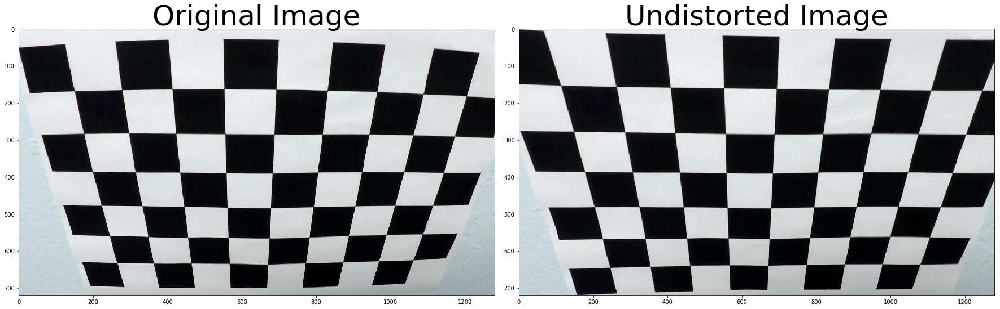

In [9]:
################ distortion images to raw images: 

image_test= cv2.imread('./camera_cal/calibration2.jpg')  # here I applied for calibration2 image 

undist = cv2.undistort(image_test, mtx, dist, None, mtx )

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image_test)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


        


## Step 4: Use color transforms, gradients threshhold to create a thresholded binary image

In this step I applied diffrent threshholds and color transform to the orginial image and then I combined all threshholds and color transform to create a threshhold image.

In [11]:
###### read a test image and undistor it for using color and gradinet thresholding

img = cv2.imread('./test_images/test1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.undistort(img, mtx, dist, None, mtx)

### step 4_1: Apply X and Y Gradiant threshhold

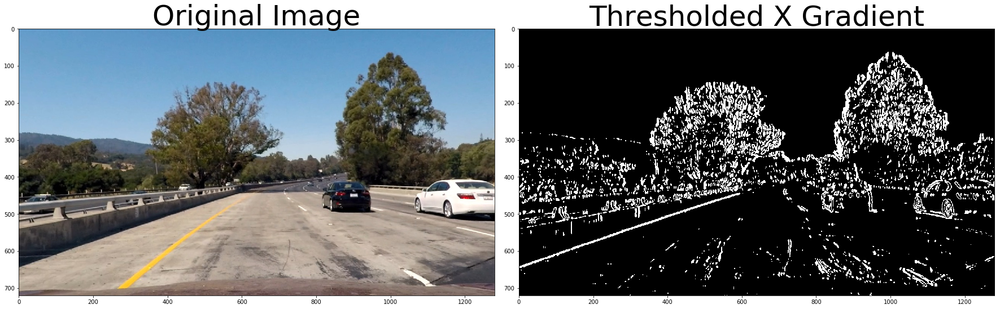

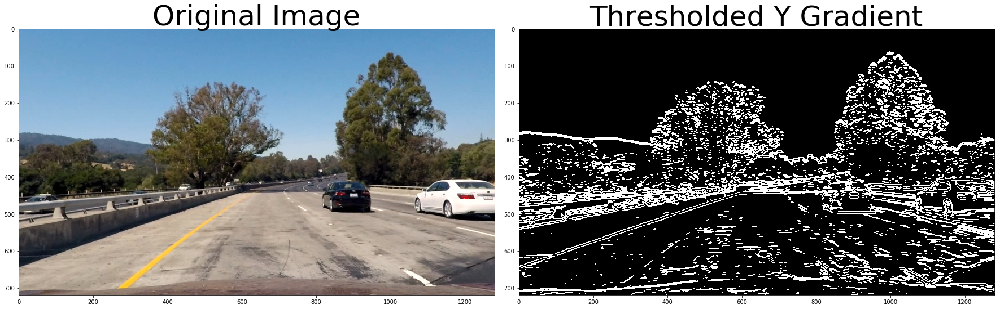

In [12]:
#### applying sobel of x and y 

def abs_sobel_thresh(img, orient='x',  sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
   #  Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 1) Take the derivative  and absosulut value in x or y given orient = 'x' or 'y'
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize= sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize= sobel_kernel))
   
    # 2) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # 3) Create a mask of 1's where the scaled gradient magnitude # is > thresh_min and < thresh_max
            
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1        
    # 6) Return this mask as your binary_output image
    
    return grad_binary

ksize= 15
gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(20, 100))

# Plot the result for x and y 

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(gradx, cmap='gray')
ax2.set_title('Thresholded X Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grady, cmap='gray')
ax2.set_title('Thresholded Y Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### Step 4_2: Apply Magnitude of the Gradient 

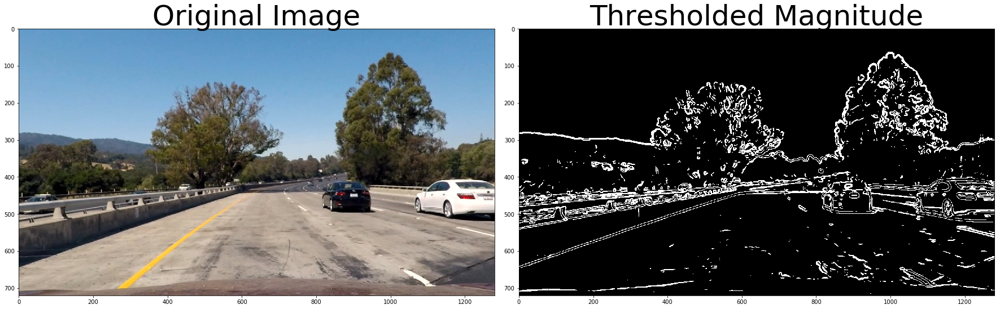

In [15]:
###### applying magnitude of gradinet 


def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return mag_binary

ksize=15
mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(40, 100))


# Plot the result for magnitude gradinet

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Step 4_3: Apply Direction of the Gradient

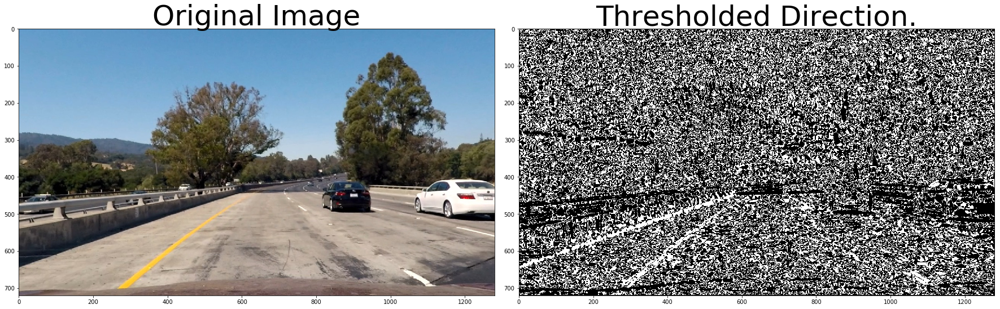

In [17]:
#### apply direction of gradinet 


def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return dir_binary
ksize=15
dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))   


# Plot the result for direction of gradinet

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Direction.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Step 4_4: Apply Color Transform

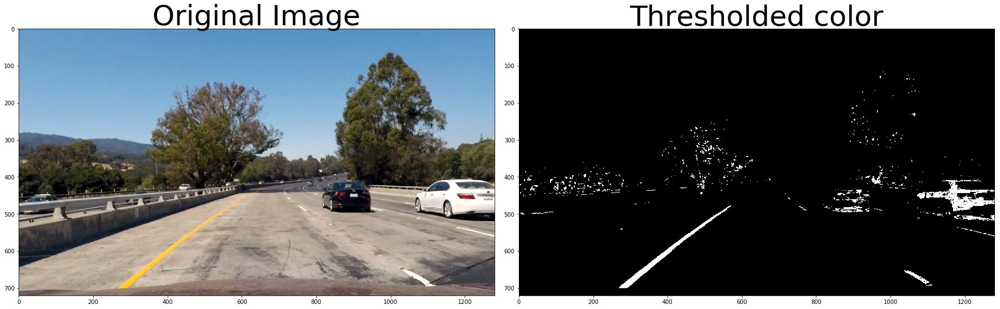

In [18]:
#### apply color transform


def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    # 2) Apply a threshold to the S channel
    S=hls[:,:,2]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
   
    return binary_output
 
hls_binary = hls_select(img, thresh=(170, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded color', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Step 4_5: Combine all Threshholds and Color Transform

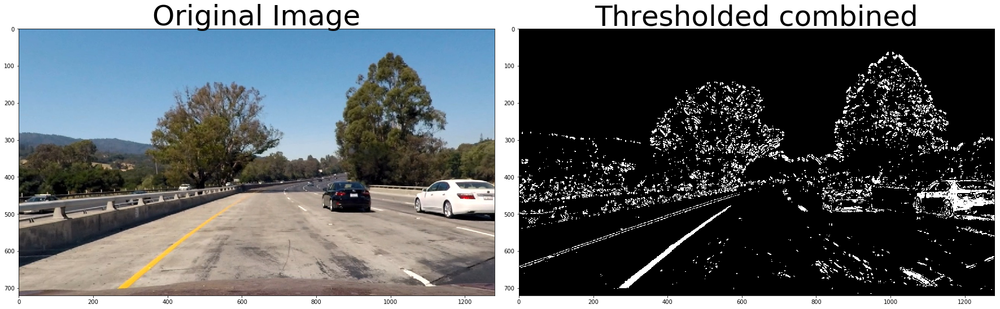

In [20]:

# Stack each channel
def combine_threshhold(gradx, grady, mag_binary, dir_binary, hls_binary, ksize=15):       
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (hls_binary == 1)] = 1

    return combined

combined = combine_threshhold(gradx, grady, mag_binary, dir_binary, hls_binary, ksize=15)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Thresholded combined', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
  

## Step 5: Apply a perspective transform to rectify binary image

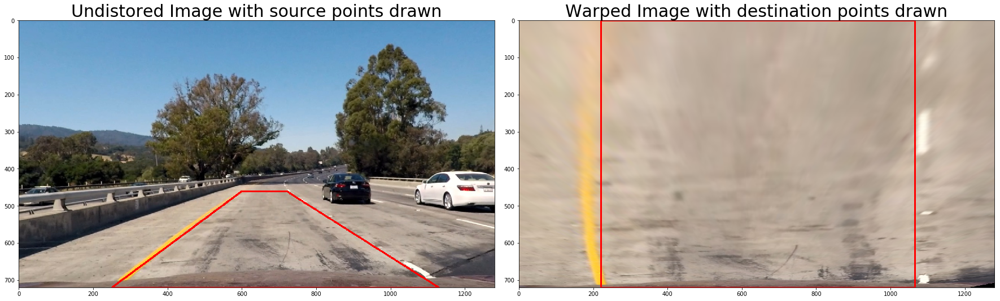

In [39]:
####### Apply a perspective transform


img_size = (img.shape[1], img.shape[0])    # image size
copy = img.copy()

b_l_src = [250, img.shape[0]] # bottom left for source
b_r_src = [1130,img.shape[0]] # bottom right for source 
t_r_src = [720,460] # top right for source
t_l_src = [600,460] # top left for source


b_l_dst = [220, img.shape[0]] # bottom left for destination
b_r_dst = [1065,img.shape[0]] # bottom right for destination
t_r_dst = [1065,0] # top right for destination
t_l_dst = [220,0] # top left for destination


# suorce points 
src = np.float32([b_l_src,b_r_src,t_r_src,t_l_src])
# destination points
dst = np.float32([b_l_dst,b_r_dst,t_r_dst,t_l_dst])

def presepective_transform(img):
    
        
        # For source points I'm grabbing the outer four detected corners
    src = np.float32([b_l_src,b_r_src,t_r_src,t_l_src])
        # For destination points, I'm arbitrarily choosing some points to be
    dst = np.float32([b_l_dst,b_r_dst,t_r_dst,t_l_dst])
        # Given src and dst points, calculate the perspective transform matrix and the inverseof it 
    M = cv2.getPerspectiveTransform(src, dst)
    M_inv = cv2.getPerspectiveTransform(dst, src)
        # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

    # Return the resulting image and matrix
    return warped, M, M_inv


warped_image, M , M_inv= presepective_transform(img)
cv2.polylines(warped_image,[np.array([b_l_dst,b_r_dst,t_r_dst,t_l_dst], np.int32).reshape((-1,1,2))],True,(255,0,0), thickness=3)
cv2.polylines(copy,[np.array([b_l_src,b_r_src,t_r_src,t_l_src], np.int32).reshape((-1,1,2))],True,(255,0,0), thickness=3)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(copy)
ax1.set_title('Undistored Image with source points drawn', fontsize=30)
ax2.imshow(warped_image)
ax2.set_title('Warped Image with destination points drawn', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## Step 6: Detect lane pixels and fit to find the lane boundary

After applying calibration, thresholding, and a perspective transform to a road image, I have a binary image where the lane lines stand out clearly. Then I need to decide explicitly which pixels are part of the lines and which belong to the left line and which belong to the right line. To do this first:

1. Finding the Lines (Histogram Peaks):
Plotting a histogram of where the binary activations occur across the image is one potential solution.
2. Finding the Lines (Sliding Window):
Use sliding windows moving upward in the image to determine where the lane lines go.
3. Finding the Lines (Search from Prior):
It helps to track the lanes through sharp curves and tricky conditions

### Step 6_1: Peaks in a Histogram

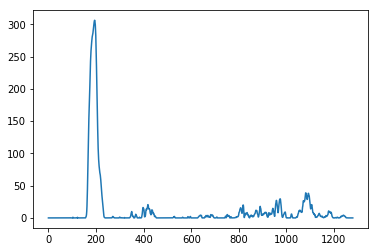

In [40]:
###### peaks in a histogram


warped_combined = presepective_transform(combined)[0]
histogram = np.sum(warped_combined[warped_combined.shape[0]//2:,:], axis=0)
    

# Visualize the resulting histogram
plt.plot(histogram)

### Step 6_2: Implement Sliding Windows and Fit a Polynomial

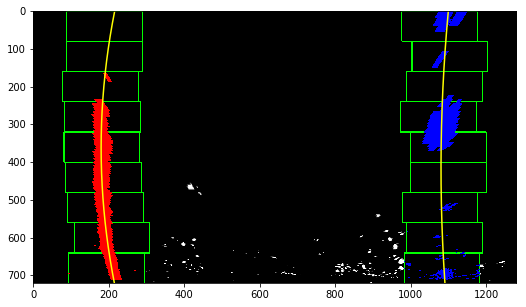

In [41]:
#############   Implement Sliding Windows and Fit a Polynomial

def find_lane_pixels(warped_combined , plot=False):
    
    
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((warped_combined, warped_combined, warped_combined))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(warped_combined.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped_combined.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped_combined.shape[0] - (window+1)*window_height
        win_y_high = warped_combined.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        if(plot==True):
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Colors in the left and right lane regions
    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_combined.shape[0]-1, warped_combined.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    #### Visualization
    plt.figure(figsize=(20,5))
    plt.imshow(out_img.astype('uint8'))
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    return left_fit, right_fit, left_fitx, right_fitx, out_img

l_f, r_f, l_fx, r_fx, o =find_lane_pixels(warped_combined , plot=True)


### Step 6_3: Search from Prior and detect the lane lines

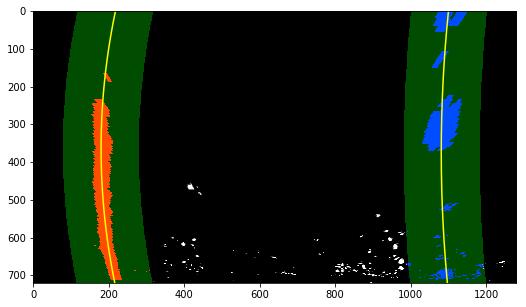

In [42]:
def search_around_poly(warped_combined,l_f,r_f):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100
    left_fit=l_f
    right_fit=r_f
    # Grab activated pixels
    nonzero = warped_combined.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2]-margin))
    &(nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2]+margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2)+ right_fit[1]*nonzeroy + right_fit[2]-margin))
    &(nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2]+margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_combined.shape[0] - 1, warped_combined.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((warped_combined, warped_combined, warped_combined))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image

    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    plt.figure(figsize=(20,5))
    
    plt.imshow(out_img.astype('uint8'))
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    return left_fit, right_fit, left_fitx, right_fitx, out_img

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
l_flane, r_flane, l_fx, r_fx, o = search_around_poly(warped_combined,l_f,r_f)



## Step 7: Determine the curvature of the lane and vehicle position with respect to center

In [43]:
## Measuring Curvature

def measure_curvature_real(l_fx, r_fx,img_size):
    
  
    ploty = np.linspace(0, img.shape[0] - 1, img.shape[0])
    midell_x = img.shape[1]//2
    car_pos = ( l_fx[-1] +  r_fx[-1])/2
    leftx = l_fx[::-1]  # Reverse to match top-to-bottom in y
    rightx = r_fx[::-1]  # Reverse to match top-to-bottom in y
    left_fit = np.polyfit(ploty, leftx, 2)
    right_fit = np.polyfit(ploty, rightx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx *xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty *ym_per_pix, rightx * xm_per_pix, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    #####  Implement the calculation of R_curve (radius of curvature) #####
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval *ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])  ## Implement the calculation of the left line here
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval* ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])   ## Implement the calculation of the right line here
    
    ## Horizontal car offset 
    offsetx = (midell_x - car_pos) * xm_per_pix
    
    return offsetx, left_curverad, right_curverad


# Calculate the radius of curvature in meters for both lane lines
offsetx, left_curverad, right_curverad = measure_curvature_real(l_fx, r_fx, img_size)
 
print(' left_curverad',left_curverad, 'm')
print(' right_curverad', right_curverad,'m')
print(' offsetx',offsetx,'m')
   
    

    


 left_curverad 573.038849515 m
 right_curverad 1209.70525131 m
 offsetx -0.0886968518297 m


## Step 8: Warp the detected lane boundaries back onto the original image

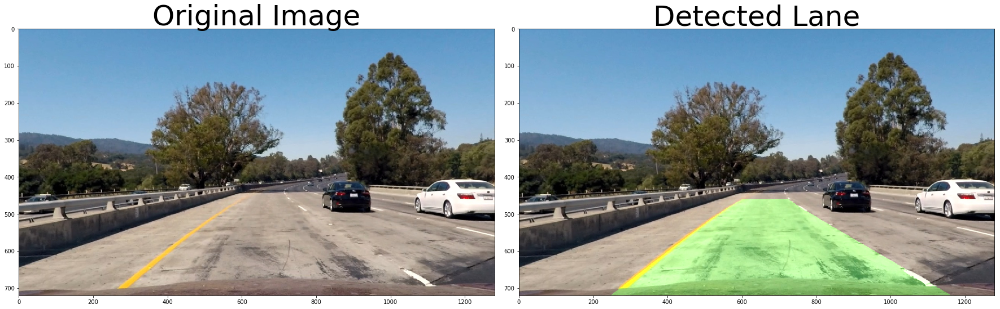

In [44]:
def detect_line(img,warped_combined,l_fx,r_fx, M_inv):

    warp_zero = np.zeros_like(warped_combined).astype(np.uint8)
   
    out_img = np.dstack((warp_zero, warp_zero, warp_zero))*255

    ploty = np.linspace(0, warped_combined.shape[0] - 1, warped_combined.shape[0] )

    left_line_window = np.array(np.transpose(np.vstack([l_fx, ploty])))

    right_line_window = np.array(np.flipud(np.transpose(np.vstack([r_fx, ploty]))))

    line_points = np.vstack((left_line_window, right_line_window))

    cv2.fillPoly(out_img, np.int_([line_points]), [0,255, 0])
    
    img_size = (img.shape[1], img.shape[0])

    unwarped = cv2.warpPerspective(out_img, M_inv, img_size)

    unwarp_img = cv2.addWeighted(img, 1, unwarped, 0.3, 0)
    
    return unwarp_img

unwarp_img = detect_line(img, warped_combined,l_fx,r_fx, M_inv)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(unwarp_img)
ax2.set_title('Detected Lane', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Step 9: Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

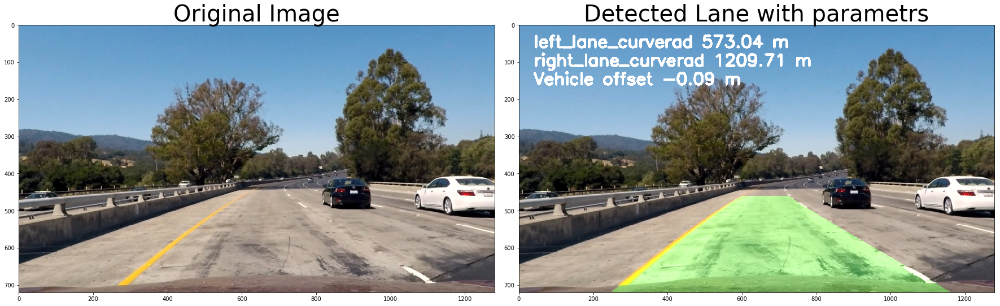

In [47]:
# display lane curvature and center offset with the lane bounderies on the image 

def metrics (unwarp_img,l_fx,r_fx):
    
    offsetx, left_curverad, right_curverad = measure_curvature_real(l_fx, r_fx, img_size)
    out_img = unwarp_img.copy()
    cv2.putText(out_img, "left_lane_curverad %.2f m" % left_curverad , (40, 60), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    cv2.putText(out_img, "right_lane_curverad %.2f m" % right_curverad,(40, 110), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    cv2.putText(out_img, "Vehicle offset %.2f m"% offsetx,(40, 160), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 5)
    return out_img

out_img = metrics (unwarp_img,l_fx,r_fx)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=40)
ax2.imshow(out_img)
ax2.set_title('Detected Lane with parametrs', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Step 10: Pipeline Video

In [48]:
class ProcessImage:
    def __init__(self, images):
        images = glob.glob(images)

        # Calibrate camera
        self.ret, self.mtx, self.dist, self.rvecs, self.tvecs = calibrate_camera(images)
        
    def __call__(self, img):
        
        # Undistord image
        img = cv2.undistort(img, mtx, dist, None, mtx)
        ksize=15
        
        # Calculate directional gradient
        gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(30, 100))
        
        # Calculate gradient magnitude 
        mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(70, 100))
        
        # Calculate gradient direction
        dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))   

        # Calculate color threshold
        hls_binary = hls_select(img, thresh=(170, 255))
        
        # Combine all the thresholds to identify the lane lines
        combined = combine_threshhold(gradx, grady, mag_binary, dir_binary, hls_binary, ksize=15)
        
        # Apply a perspective transform 
        warped_combined, M , M_inv = presepective_transform(combined)
        
        # find lane detection
        l_flane, r_flane, l_fx, r_fx, o = search_around_poly(warped_combined,l_f,r_f)  
        
        # Warp the detected lane boundaries 
        unwarp_img = detect_line(img, warped_combined, l_fx, r_fx, M_inv) 
        
        # Add metrics 
        out_img = metrics (unwarp_img,l_fx,r_fx) 
        
        return out_img

Camera successfully calibrated
[MoviePy] >>>> Building video ./project_video_solution.mp4
[MoviePy] Writing video ./project_video_solution.mp4


100%|█████████▉| 1260/1261 [09:36<00:00,  2.07it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_solution.mp4 

CPU times: user 7min 13s, sys: 9.67 s, total: 7min 23s
Wall time: 9min 39s


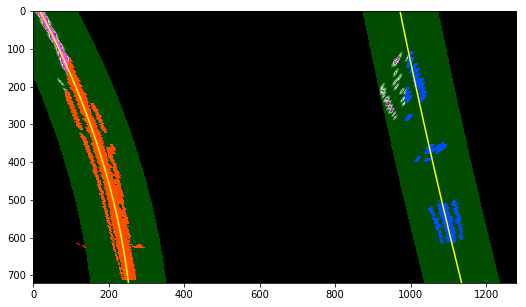

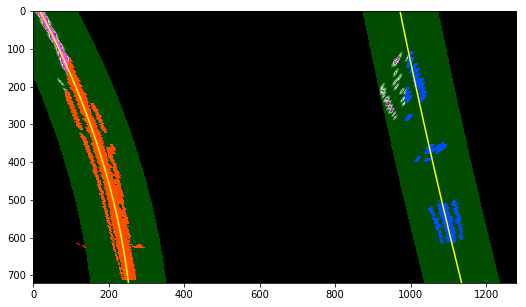

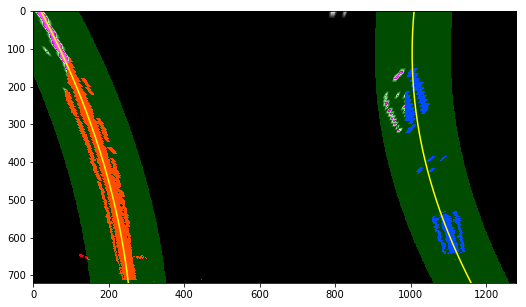

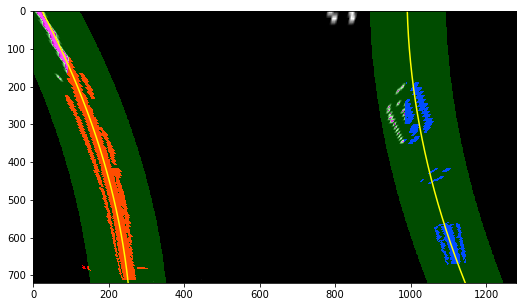

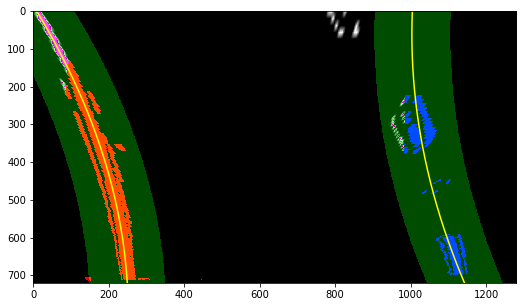

...

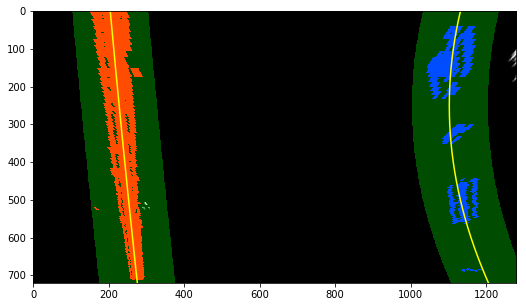

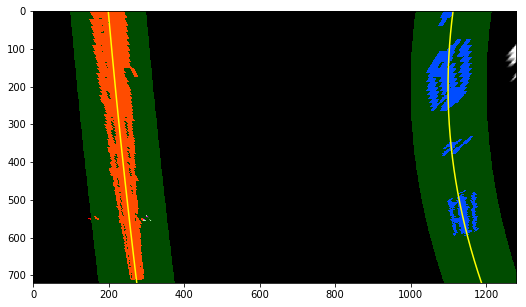

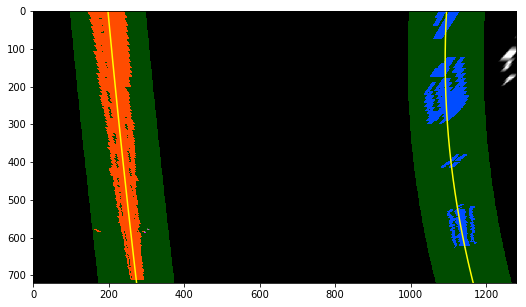

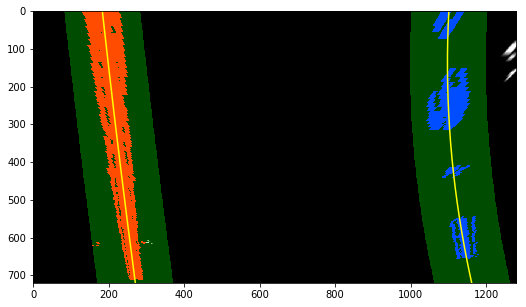

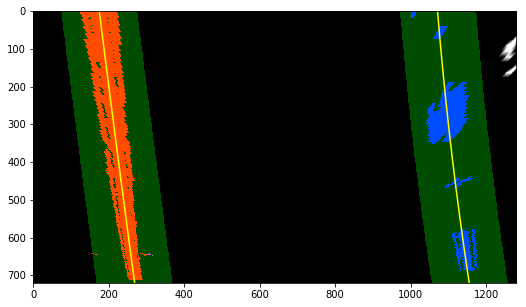

In [49]:
input_video = './project_video.mp4'
output_video = './project_video_solution.mp4'

clip1 = VideoFileClip(input_video)

# Process video frames with our 'process_image' function
process_image = ProcessImage('./camera_cal/calibration*.jpg')

white_clip = clip1.fl_image(process_image)

%time white_clip.write_videofile(output_video, audio=False)

In [50]:
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(output_video))